## Assignment 7.3
Create the optimal hotel recommendations for Expedia’s users that are searching for a hotel to book. For this assignment, you need to predict which “hotel cluster” the user is likely to book, given his (or her) search details.

##### Step 1
Import packages

In [56]:
import datetime
import pydotplus
import pandas_profiling
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats
from datetime import datetime
from sklearn import tree
from sklearn.decomposition import PCA
from sklearn.naive_bayes import GaussianNB
from sklearn.preprocessing import StandardScaler
from sklearn.neural_network import MLPClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis

Load in the data and have a quick look at it

In [61]:
df = pd.read_csv('train.csv', nrows = 2000000)
df.head()

,date_time,site_name,posa_continent,user_location_country,user_location_region,user_location_city,orig_destination_distance,user_id,is_mobile,is_package,...,srch_children_cnt,srch_rm_cnt,srch_destination_id,srch_destination_type_id,is_booking,cnt,hotel_continent,hotel_country,hotel_market,hotel_cluster
0,2014-08-11 07:46:59,2,3,66,348,48862,2234.2641,12,0,1,...,0,1,8250,1,0,3,2,50,628,1
1,2014-08-11 08:22:12,2,3,66,348,48862,2234.2641,12,0,1,...,0,1,8250,1,1,1,2,50,628,1
2,2014-08-11 08:24:33,2,3,66,348,48862,2234.2641,12,0,0,...,0,1,8250,1,0,1,2,50,628,1
3,2014-08-09 18:05:16,2,3,66,442,35390,913.1932,93,0,0,...,0,1,14984,1,0,1,2,50,1457,80
4,2014-08-09 18:08:18,2,3,66,442,35390,913.6259,93,0,0,...,0,1,14984,1,0,1,2,50,1457,21


In [62]:
df.profile_report()

Summarize dataset:   0%|          | 0/38 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Let's start with a little basic data exploration to see what we have to work with.

In [63]:
# Display a list of the columns and the number of unique values in each
df.nunique()

date_time                    1950684
site_name                         42
posa_continent                     5
user_location_country            202
user_location_region             825
user_location_city             17707
orig_destination_distance     766097
user_id                        64743
is_mobile                          2
is_package                         2
channel                           11
srch_ci                         1136
srch_co                         1143
srch_adults_cnt                   10
srch_children_cnt                 10
srch_rm_cnt                        9
srch_destination_id            22575
srch_destination_type_id           8
is_booking                         2
cnt                               57
hotel_continent                    7
hotel_country                    207
hotel_market                    2094
hotel_cluster                    100
dtype: int64

##### Step 2

After evaluating the most basic information, it seems that there are a few things that need to be done:
* Remove rows with null/NaN values (a maximum of 354 rows)

* Separate the date and time into separate columns

* Pull out month from two dates
  * date_time (when the user is making their plans)
  * srch_ci (when the user is planning to travel)

* Calcluate 2 timeframes
  * The length of time from the date of search to the travel date
  * The length of stay

* Focus on the country with value 66 (since more than half of my observations have that value) 

* Drop the following columns
  * date_time as this is irrelevant now
  * posa_continent (as it is exactly correlated to the site_name column)
  * orig_destination_distance as over 1/3 of the values are null/NaN
  * user_id (as it only is used to identify the user)
  * srch_ci (used only to calculate planning time)
  * srch_co (used only to calculate length of stay)
  * user_date (used only to calculate planning time)
 
NOTE: time of inquiry is not being removed as time of day may make a difference. I also am not calculating day of the week or day of the month, even though those might be relevant.

In [66]:
df.dropna(inplace=True)

# Separate date and time, convert all dates to datetime format
df[['user_date','user_time']] = df.date_time.str.split(expand=True)
df['user_date'] = pd.to_datetime(df['user_date'])
df['user_time'] = pd.to_datetime(df['user_time'])
df['planning_month'] = [int(round(m.month)) for m in df['user_date']]
df['srch_ci'] = pd.to_datetime(df['srch_ci'])
df['travel_month'] = [int(round(m.month)) for m in df['srch_ci']]
df['srch_co'] = pd.to_datetime(df['srch_co'])

# Calculate planning & trip length, convert # days to int
df['planning_time'] = df['srch_ci']-df['user_date']
df['planning_time'] = df['planning_time'].dt.days.astype('int64')
df['trip_length'] = df['srch_co']-df['srch_ci']
df['trip_length'] = df['trip_length'].dt.days.astype('int64')

# Convert time data to integer
df['user_time'] = [int(round(t.timestamp())) * -1 for t in df['user_time']]

df.dtypes

date_time                            object
site_name                             int64
posa_continent                        int64
user_location_country                 int64
user_location_region                  int64
user_location_city                    int64
orig_destination_distance           float64
user_id                               int64
is_mobile                             int64
is_package                            int64
channel                               int64
srch_ci                      datetime64[ns]
srch_co                      datetime64[ns]
srch_adults_cnt                       int64
srch_children_cnt                     int64
srch_rm_cnt                           int64
srch_destination_id                   int64
srch_destination_type_id              int64
is_booking                            int64
cnt                                   int64
hotel_continent                       int64
hotel_country                         int64
hotel_market                    

In [67]:
df.head()

,date_time,site_name,posa_continent,user_location_country,user_location_region,user_location_city,orig_destination_distance,user_id,is_mobile,is_package,...,hotel_continent,hotel_country,hotel_market,hotel_cluster,user_date,user_time,planning_month,travel_month,planning_time,trip_length
0,2014-08-11 07:46:59,2,3,66,348,48862,2234.2641,12,0,1,...,2,50,628,1,2014-08-11,-1612252019,8,8,16,4
1,2014-08-11 08:22:12,2,3,66,348,48862,2234.2641,12,0,1,...,2,50,628,1,2014-08-11,-1612254132,8,8,18,4
2,2014-08-11 08:24:33,2,3,66,348,48862,2234.2641,12,0,0,...,2,50,628,1,2014-08-11,-1612254273,8,8,18,4
3,2014-08-09 18:05:16,2,3,66,442,35390,913.1932,93,0,0,...,2,50,1457,80,2014-08-09,-1612289116,8,11,106,5
4,2014-08-09 18:08:18,2,3,66,442,35390,913.6259,93,0,0,...,2,50,1457,21,2014-08-09,-1612289298,8,11,106,5


In [68]:
# Remove unnecessary data 
df.drop(columns=['date_time', 'posa_continent', 'orig_destination_distance', 
                 'user_id', 'srch_ci', 'srch_co', 'user_date'], inplace=True)

df.head()

,site_name,user_location_country,user_location_region,user_location_city,is_mobile,is_package,channel,srch_adults_cnt,srch_children_cnt,srch_rm_cnt,...,cnt,hotel_continent,hotel_country,hotel_market,hotel_cluster,user_time,planning_month,travel_month,planning_time,trip_length
0,2,66,348,48862,0,1,9,2,0,1,...,3,2,50,628,1,-1612252019,8,8,16,4
1,2,66,348,48862,0,1,9,2,0,1,...,1,2,50,628,1,-1612254132,8,8,18,4
2,2,66,348,48862,0,0,9,2,0,1,...,1,2,50,628,1,-1612254273,8,8,18,4
3,2,66,442,35390,0,0,3,2,0,1,...,1,2,50,1457,80,-1612289116,8,11,106,5
4,2,66,442,35390,0,0,3,2,0,1,...,1,2,50,1457,21,-1612289298,8,11,106,5


Now we'll do a quick view of the data more visually

Now we need to separate our data to pull out the dependant variable.

In [70]:
result=df.pop('hotel_cluster')
df.head()

,site_name,user_location_country,user_location_region,user_location_city,is_mobile,is_package,channel,srch_adults_cnt,srch_children_cnt,srch_rm_cnt,...,is_booking,cnt,hotel_continent,hotel_country,hotel_market,user_time,planning_month,travel_month,planning_time,trip_length
0,2,66,348,48862,0,1,9,2,0,1,...,0,3,2,50,628,-1612252019,8,8,16,4
1,2,66,348,48862,0,1,9,2,0,1,...,1,1,2,50,628,-1612254132,8,8,18,4
2,2,66,348,48862,0,0,9,2,0,1,...,0,1,2,50,628,-1612254273,8,8,18,4
3,2,66,442,35390,0,0,3,2,0,1,...,0,1,2,50,1457,-1612289116,8,11,106,5
4,2,66,442,35390,0,0,3,2,0,1,...,0,1,2,50,1457,-1612289298,8,11,106,5


<AxesSubplot:xlabel='hotel_cluster', ylabel='Count'>

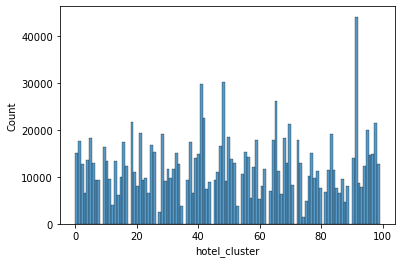

In [71]:
# Display a histogram of the hotel cluster (the dependent variable)
sns.histplot(result)

##### Step 3

Now, let's have a look at a few prediction models. Let's start with a Random Forest Classifier. 

First, we'll combine the data and separate into train and test sets.

In [73]:
# Let's save the names of the columns, and put the dataframe back together
features_full = df.columns.values.tolist()
df['hotel_cluster'] = result

# Separate into training and testing sets, set other needed info
train_full, test_full = train_test_split(df, test_size=0.3)

print('Size of the full training data is:', train_full.shape)
print('Size of the full test data is:', test_full.shape)

Size of the full training data is: (886817, 23)
Size of the full test data is: (380065, 23)


Now run the Random Forest

In [74]:
# Train Random Forest
rfc = RandomForestClassifier(n_estimators = 100, min_impurity_decrease = 0.000010, random_state=0)
rfc.fit(train_full[features_full], train_full['hotel_cluster'])

# Make Predictions
train_full['rfc_predictions'] = rfc.predict(train_full[features_full])
test_full['rfc_predictions'] = rfc.predict(test_full[features_full])

# Calculate Accuracy
rfc_train_full_accuracy = train_full[train_full.rfc_predictions == train_full.hotel_cluster].shape[0]/train_full.shape[0]
rfc_test_full_accuracy = test_full[test_full.rfc_predictions == test_full.hotel_cluster].shape[0]/test_full.shape[0]

print('Full data training accuracy for Random Forest is: {:.4f}'.format(rfc_train_full_accuracy))
print('Full data test accuracy for Random Forest is: {:.4f}'.format(rfc_test_full_accuracy))

Full data training accuracy for Random Forest is: 0.1292
Full data test accuracy for Random Forest is: 0.1268


Let's see how a Decision Tree Classifier does.

In [75]:
# Train Decision Tree
dtc = tree.DecisionTreeClassifier()
dtc = dtc.fit(train_full[features_full], train_full['hotel_cluster'])

# Make Predictions
train_full['dtc_predictions'] = dtc.predict(train_full[features_full])
test_full['dtc_predictions'] = dtc.predict(test_full[features_full])

# Calculate Accuracy
dtc_train_full_accuracy = train_full[train_full.dtc_predictions == train_full.hotel_cluster].shape[0]/train_full.shape[0]
dtc_test_full_accuracy = test_full[test_full.dtc_predictions == test_full.hotel_cluster].shape[0]/test_full.shape[0]

print('Full data training accuracy for Decision Tree is: {:.4f}'.format(dtc_train_full_accuracy))
print('Full data test accuracy for Decision Tree is: {:.4f}'.format(dtc_test_full_accuracy))

Full data training accuracy for Decision Tree is: 0.9455
Full data test accuracy for Decision Tree is: 0.2488


And maybe Naive Bayes

In [76]:
# Train Naive Bayes
nbg = GaussianNB()
nbg = nbg.fit(train_full[features_full], train_full['hotel_cluster'])

# Make Predictions
train_full['nbg_predictions'] = nbg.predict(train_full[features_full])
test_full['nbg_predictions'] = nbg.predict(test_full[features_full])

# Calculate Accuracy
nbg_train_full_accuracy = train_full[train_full.nbg_predictions == train_full.hotel_cluster].shape[0]/train_full.shape[0]
nbg_test_full_accuracy = test_full[test_full.nbg_predictions == test_full.hotel_cluster].shape[0]/test_full.shape[0]

print('Full data training accuracy for Naive Bayes (Gaussian) is: {:.4f}'.format(nbg_train_full_accuracy))
print('Full data test accuracy for Naive Bayes (Gaussian) is: {:.4f}'.format(nbg_test_full_accuracy))

Full data training accuracy for Naive Bayes (Gaussian) is: 0.0664
Full data test accuracy for Naive Bayes (Gaussian) is: 0.0658


Let's also check a neural network

In [77]:
# Train Neural Network
nn = MLPClassifier(random_state=1, max_iter=300)
nn = nn.fit(train_full[features_full], train_full['hotel_cluster'])

# Make Predictions
train_full['nn_predictions'] = nn.predict(train_full[features_full])
test_full['nn_predictions'] = nn.predict(test_full[features_full])

# Calculate Accuracy
nn_train_full_accuracy = train_full[train_full.nn_predictions == train_full.hotel_cluster].shape[0]/train_full.shape[0]
nn_test_full_accuracy = test_full[test_full.nn_predictions == test_full.hotel_cluster].shape[0]/test_full.shape[0]

print('Full data training accuracy for Neural Network is: {:.4f}'.format(nn_train_full_accuracy))
print('Full data test accuracy for Neural Network is: {:.4f}'.format(nn_test_full_accuracy))

Full data training accuracy for Neural Network is: 0.0349
Full data test accuracy for Neural Network is: 0.0348


The decision tree did the best with a 24% accuracy on the test data. The others might do better with more adjusting of the options. But not too bad for a first run through.